In [2]:
import cv2
import glob
import matplotlib.pyplot as plt
import numpy as np

from camera import corners_unwarp
from camera import warp_birds_eye
from camera import Calibration

from window import find_window_centroids
from window import sliding_window
from window import draw_windows

from lane_line_tracker import LaneLineTracker

from thresholding import get_edge_mask

%matplotlib inline

# Checkerboard grid pattern
PATTERN_SIZE=(9, 6)
N_WINDOWS=9

# Input image width and height
W = 1280
H = 720

# Perspective transform source and desetination points
SOURCE_POINTS = np.float32([
    [0 - 100, H], 
    [W / 2 - 76, H * .625], 
    [W / 2 + 76, H * .625], 
    [W + 100, H]
])
DESTINATION_POINTS = np.float32([
    [100, H], 
    [100, 0], 
    [W - 100, 0],
    [W - 100, H]
])

print(SOURCE_POINTS)
print(DESTINATION_POINTS)

[[ -100.   720.]
 [  564.   450.]
 [  716.   450.]
 [ 1380.   720.]]
[[  100.   720.]
 [  100.     0.]
 [ 1180.     0.]
 [ 1180.   720.]]


### Collect Calibration Parameters

In [3]:
calibration = Calibration('../camera_cal/calibration*.jpg', PATTERN_SIZE, 'calibration.p', output_status=True)
calibration.calibrate()

Loaded saved calibration file


### Show Undistorted Images - Calibration

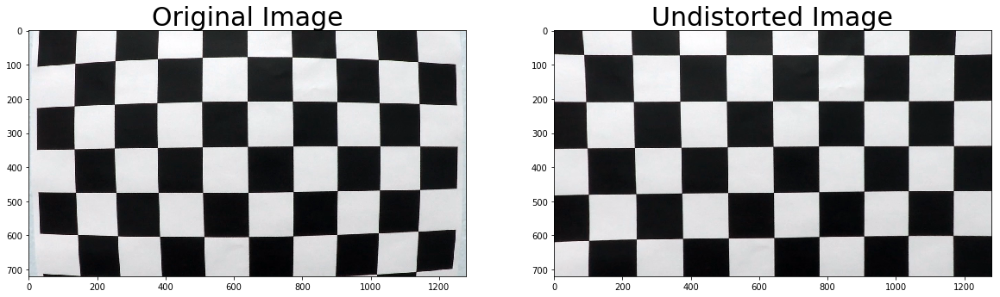

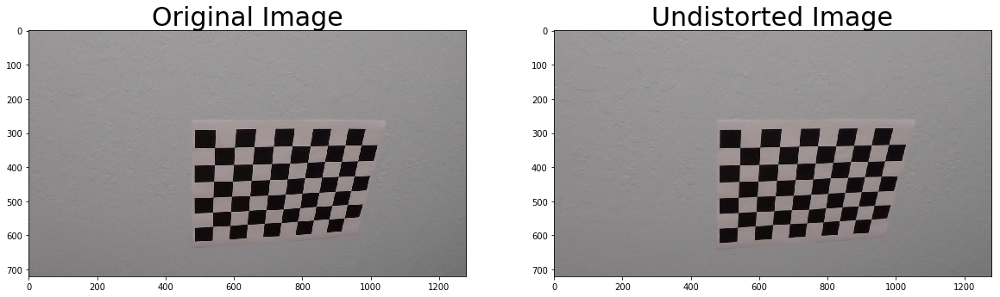

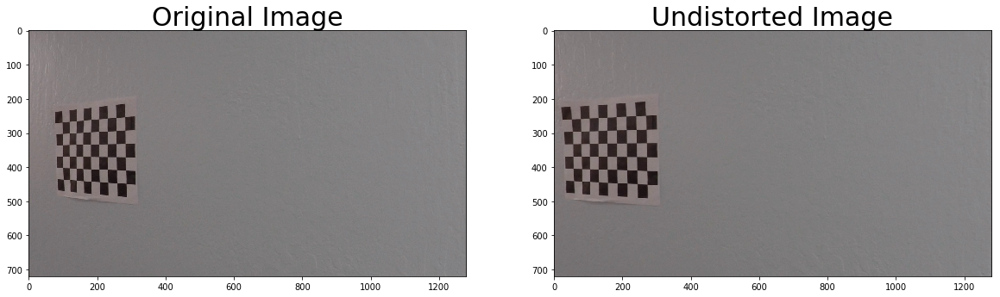

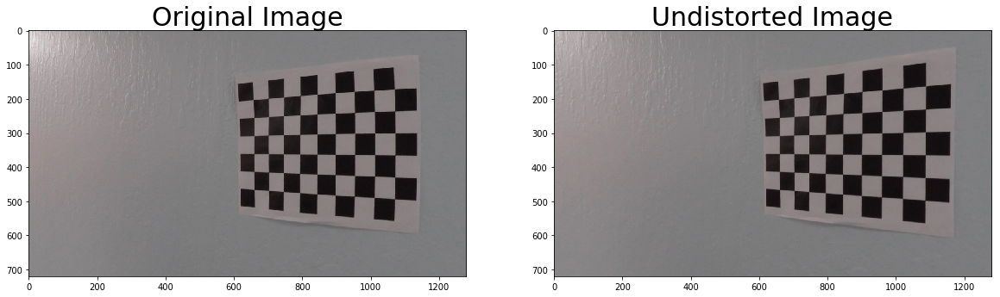

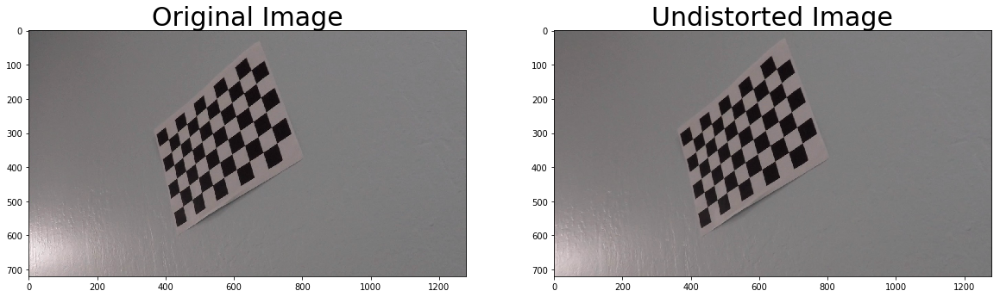

...

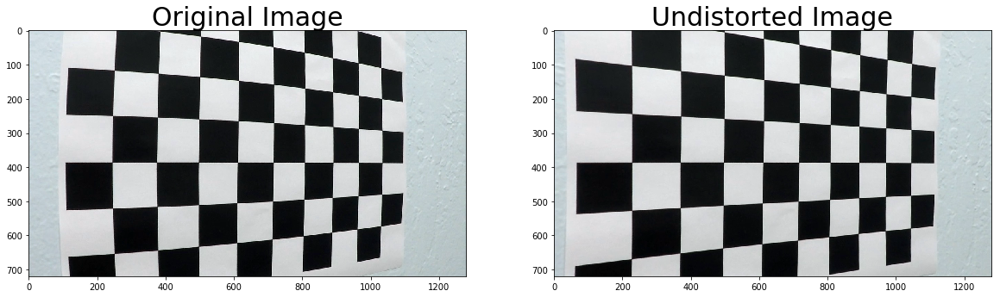

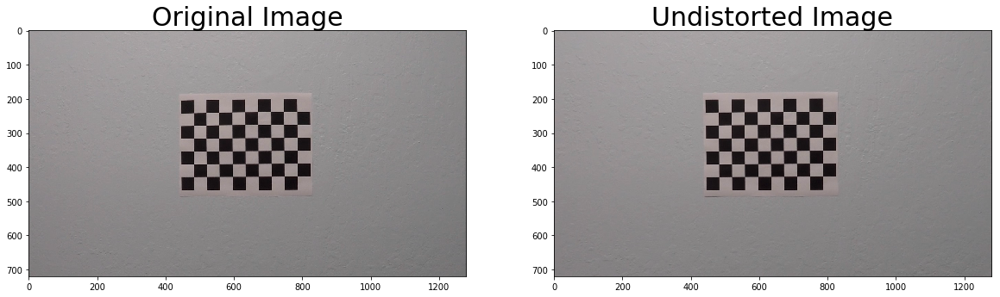

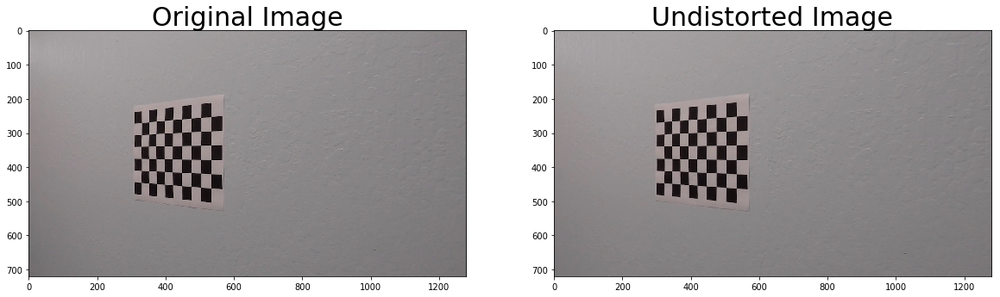

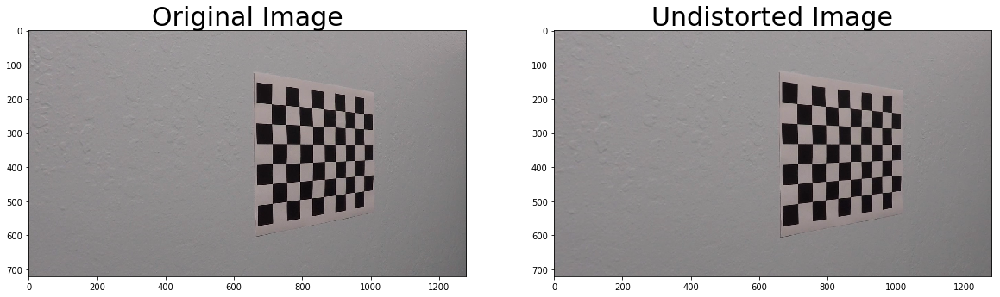

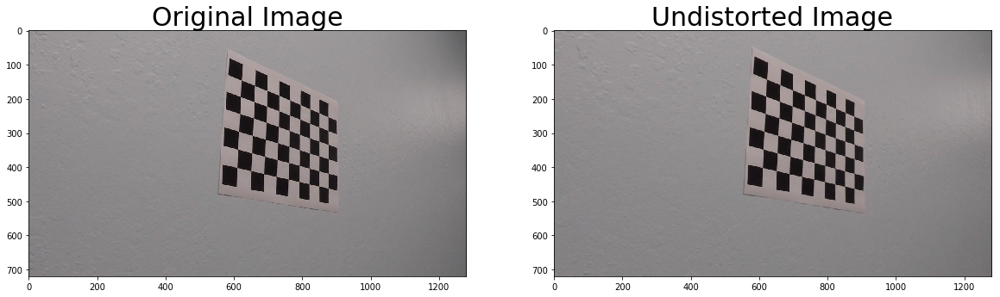

In [4]:
for index, filename in enumerate(glob.glob(calibration.images_glob)):
    img = cv2.imread(filename)    
    undist = cv2.undistort(
        img, 
        calibration.camera_matrix, 
        calibration.distortion_coefficients, 
        None, 
        calibration.camera_matrix
    )
    
    if undist is None:
        continue

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=30)
    f.savefig('../figures/chessboard-calibrations' + '{:02}'.format(index) + '.jpg')

### Show Undistorted Images - Test

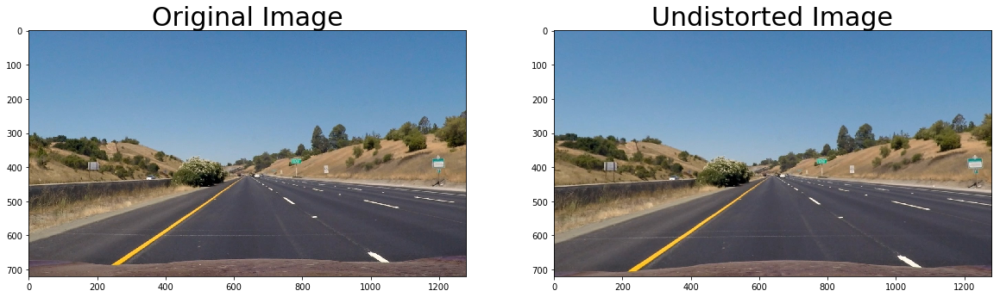

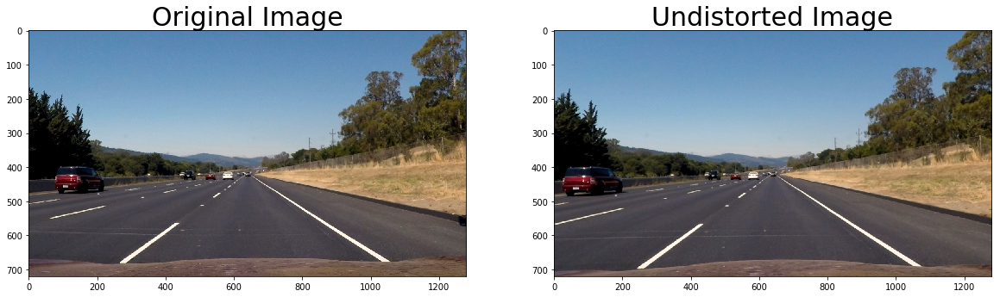

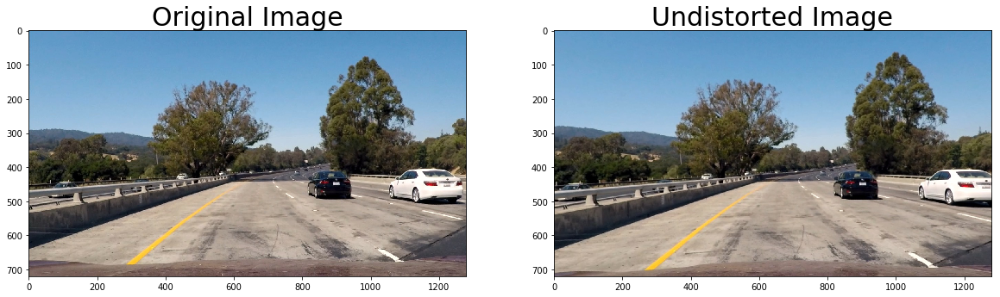

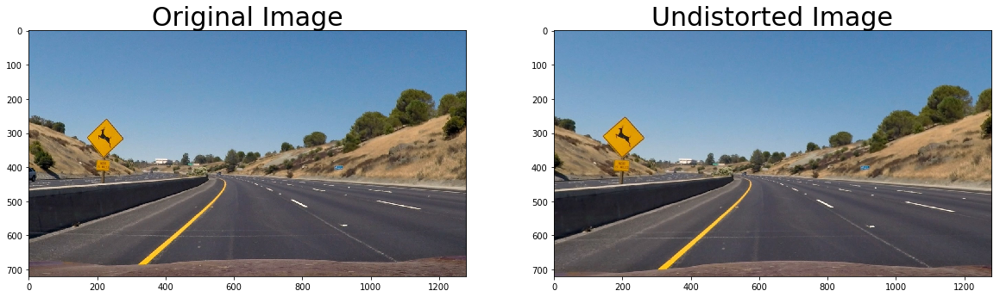

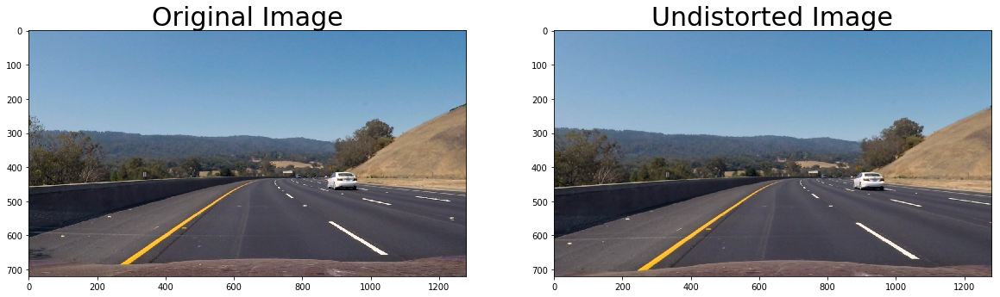

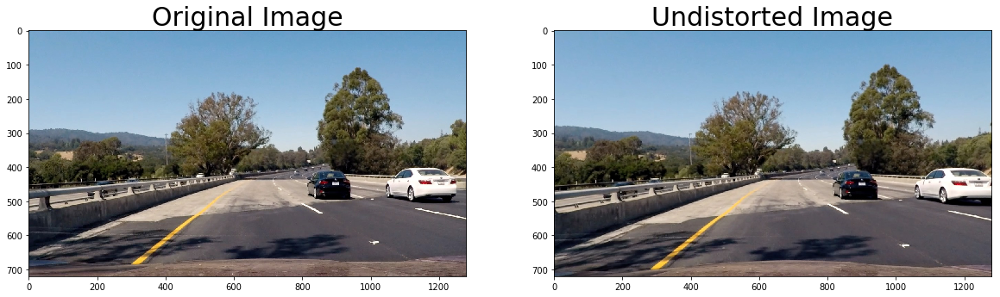

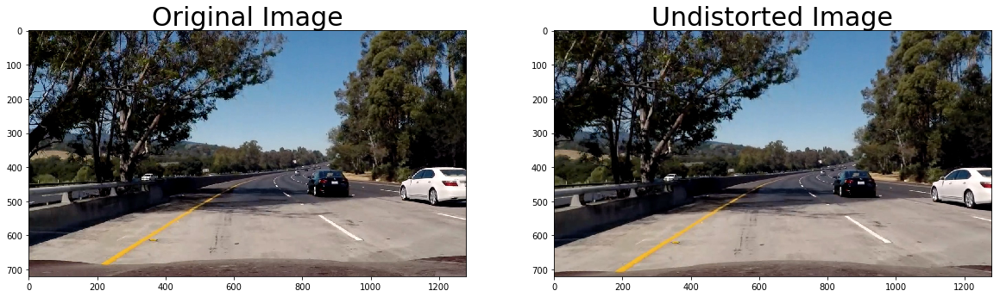

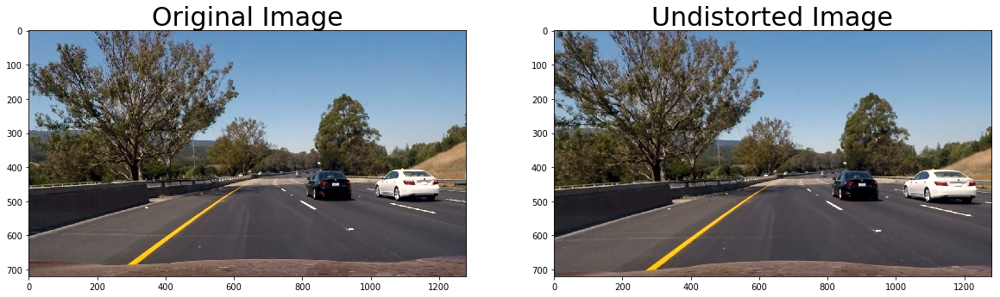

In [14]:
for index, filename in enumerate(glob.glob('../test_images/*.jpg')):
    img = cv2.imread(filename)    
    undist = cv2.undistort(
        img, 
        calibration.camera_matrix, 
        calibration.distortion_coefficients, 
        None, 
        calibration.camera_matrix
    )
    
    if undist is None:
        continue

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(cv2.cvtColor(undist, cv2.COLOR_BGR2RGB))
    ax2.set_title('Undistorted Image', fontsize=30)
    f.savefig('../figures/undistort-test-images' + '{:02}'.format(index) + '.jpg')

### Plot Calibration Images with Perspective Shift

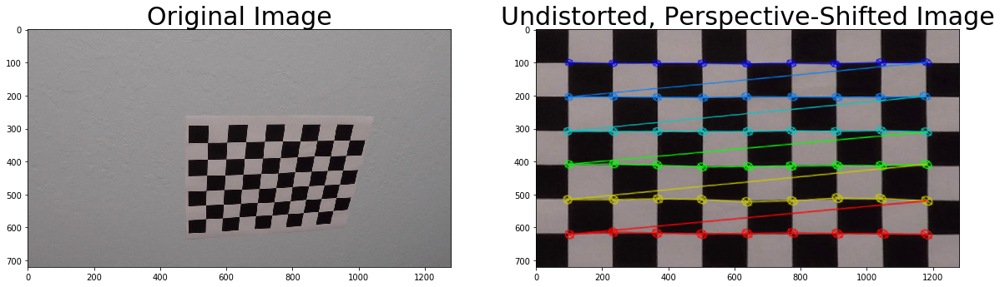

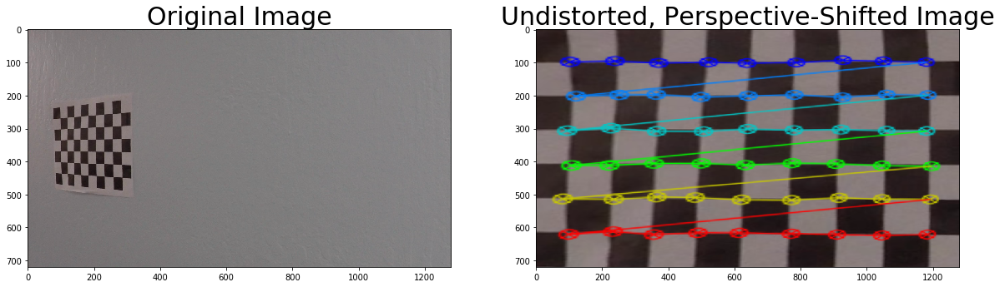

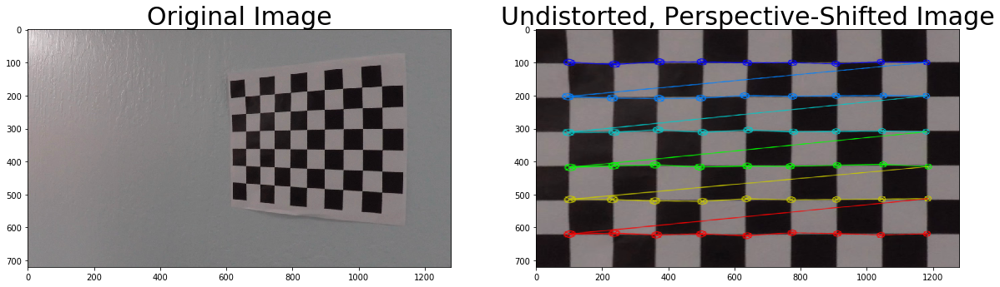

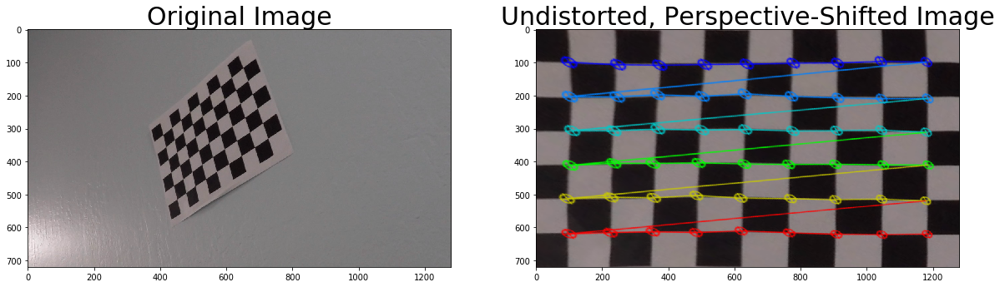

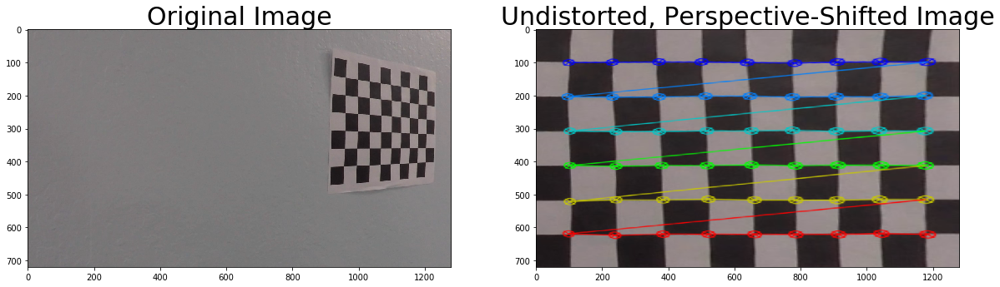

...

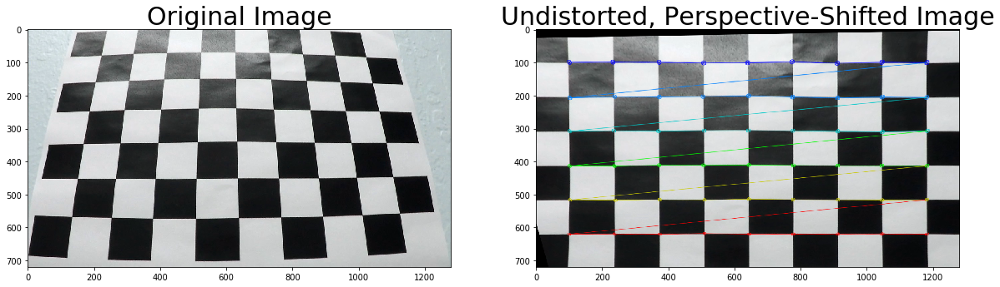

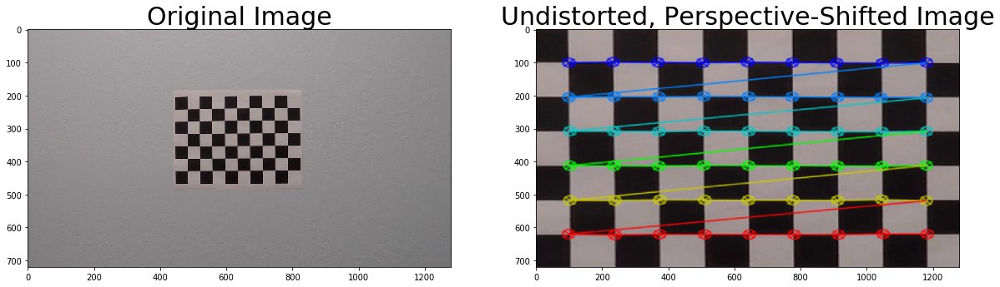

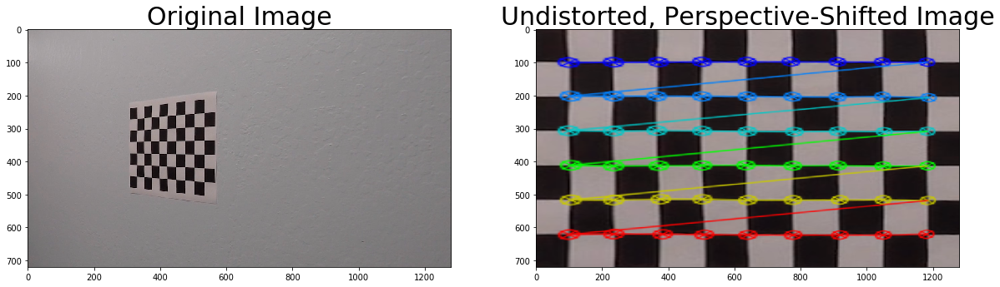

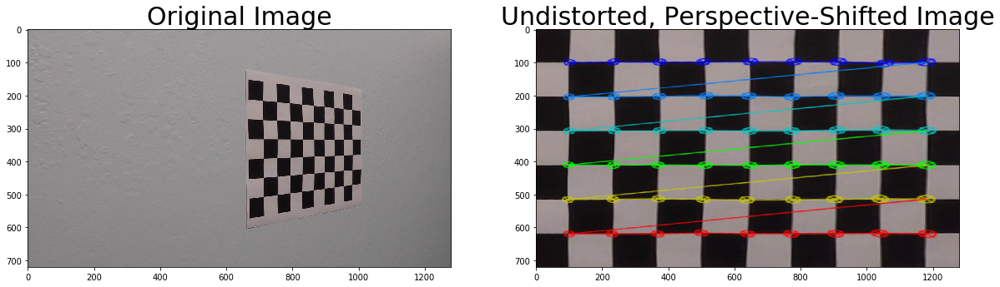

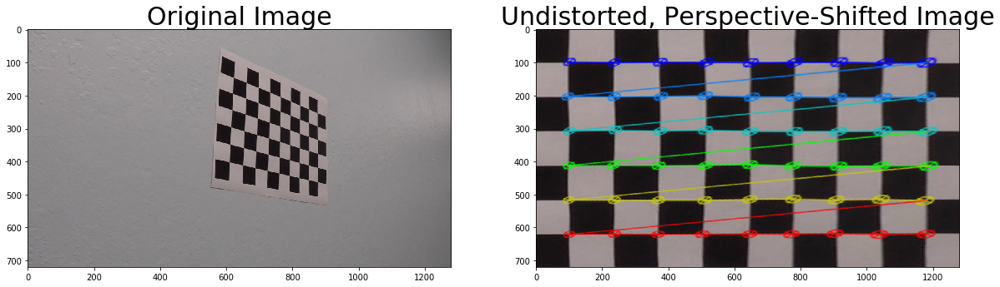

In [5]:
for index, filename in enumerate(glob.glob(calibration.images_glob)):
    img = cv2.imread(filename)
    warped, M = corners_unwarp(
        img, 
        PATTERN_SIZE[0], 
        PATTERN_SIZE[1], 
        calibration.camera_matrix, 
        calibration.distortion_coefficients
    )
    
    if warped is None:
        continue
        
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(warped)
    ax2.set_title('Undistorted, Perspective-Shifted Image', fontsize=30)
    f.savefig('../figures/chessboard-perspective-shifts' + '{:02}'.format(index) + '.jpg')

### Demonstrate Perspective Shift

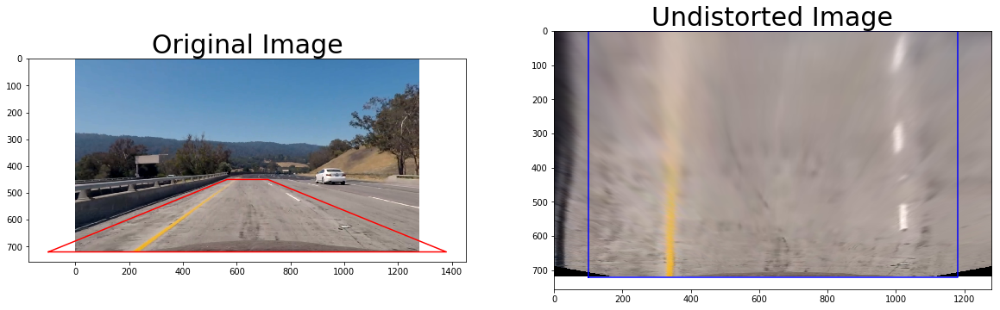

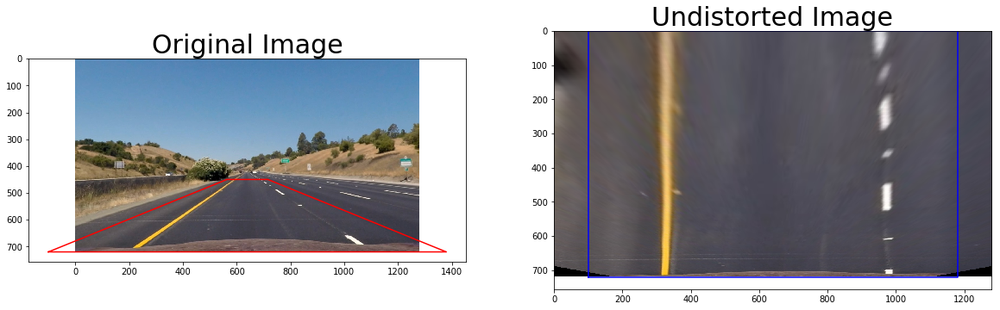

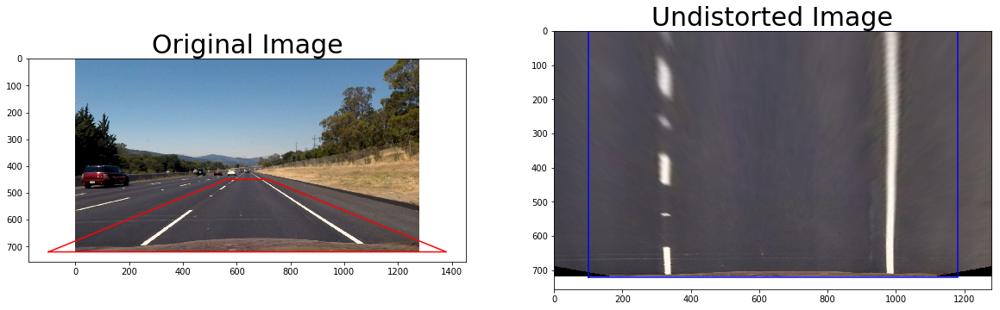

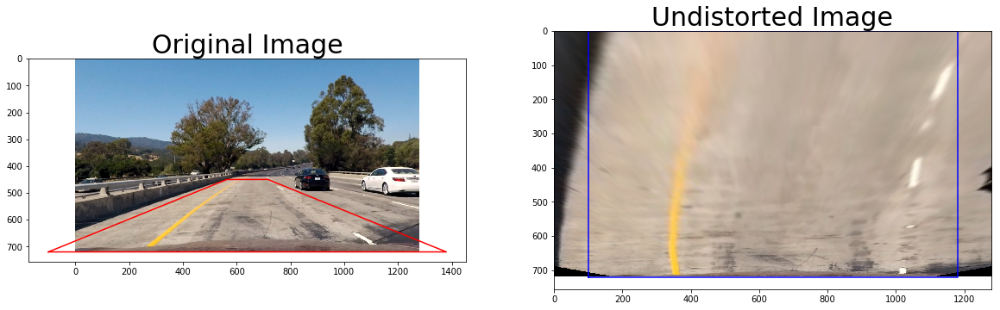

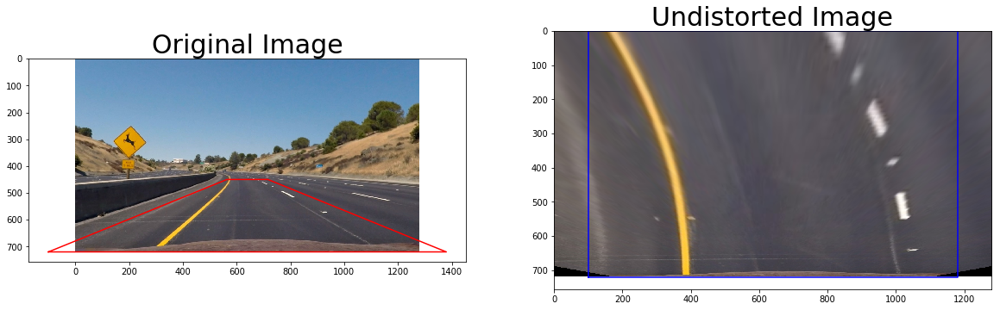

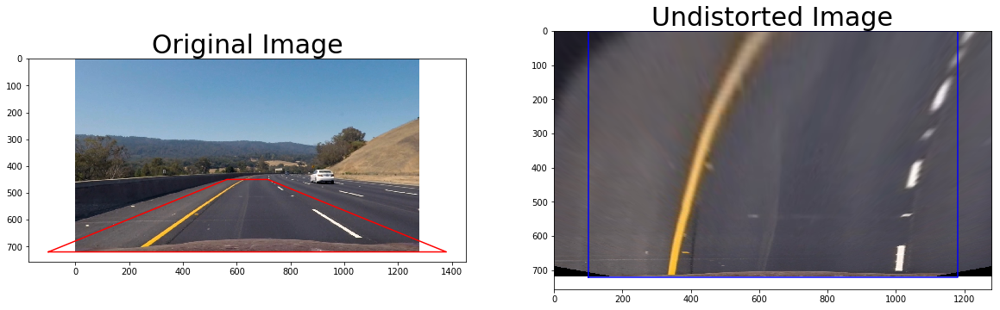

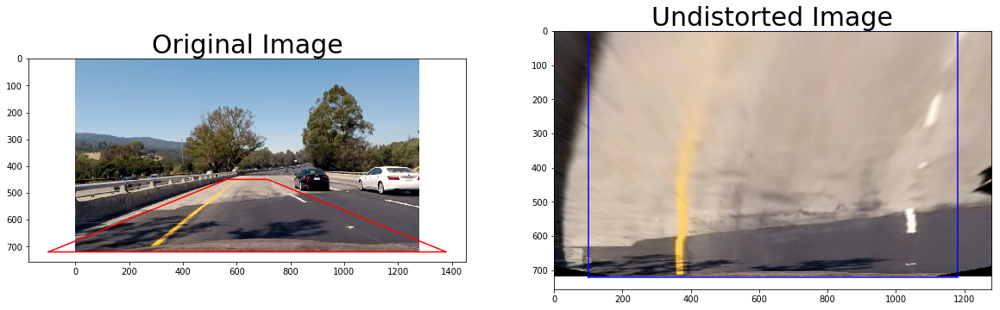

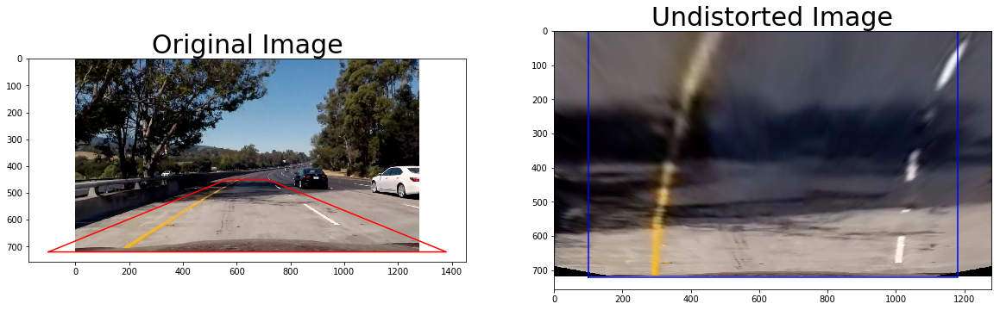

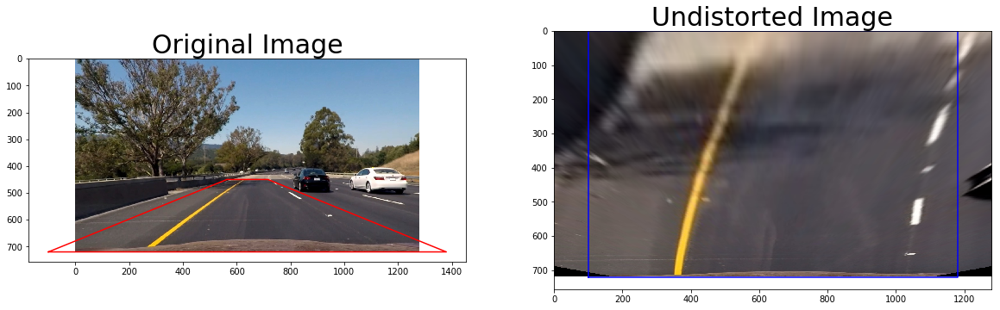

In [2]:
filenames = glob.glob('../test_images/*.jpg')

for index, image in enumerate([ cv2.imread(filename) for filename in filenames ]):
    undistorted = cv2.undistort(image, calibration.camera_matrix, calibration.distortion_coefficients, None)
    transformed_image = warp_birds_eye(
        undistorted, 
        source_points=SOURCE_POINTS, 
        destination_points=DESTINATION_POINTS
    )

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))

    # Draw source and destination shapes as cloesd polygons
    source_points = np.concatenate( (SOURCE_POINTS, SOURCE_POINTS[:1]), axis=0 )
    destination_points = np.concatenate( (DESTINATION_POINTS, DESTINATION_POINTS[:1]), axis=0 )

    ax1.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    ax1.plot(*zip(*source_points), 'r-')
    ax2.imshow(cv2.cvtColor(transformed_image, cv2.COLOR_BGR2RGB))
    ax2.plot(*zip(*destination_points), 'b-')

    ax1.set_title('Original Image', fontsize=30)
    ax2.set_title('Undistorted Image', fontsize=30)
    f.savefig('../figures/road-perspective-shift' + '{:02}'.format(index) + '.jpg')

### Lane Line Detection Thresholding

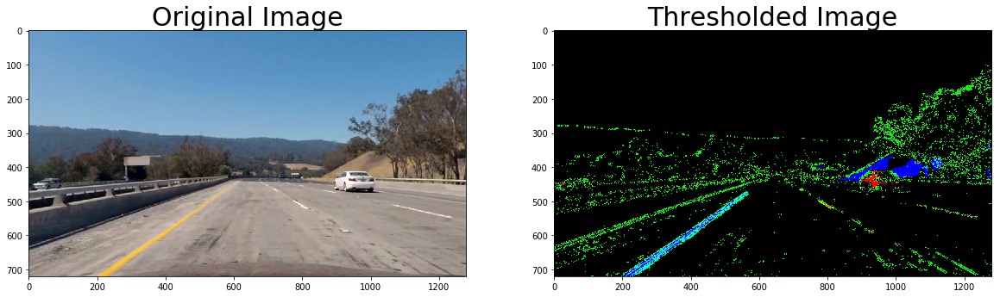

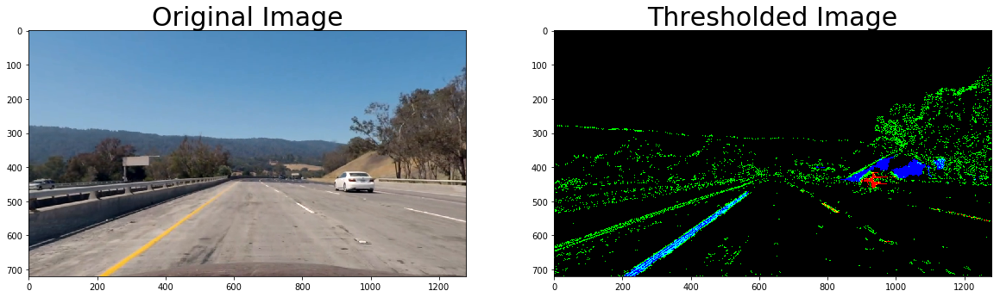

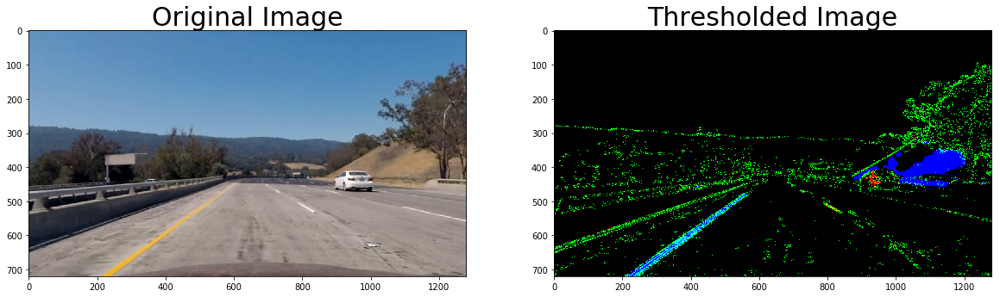

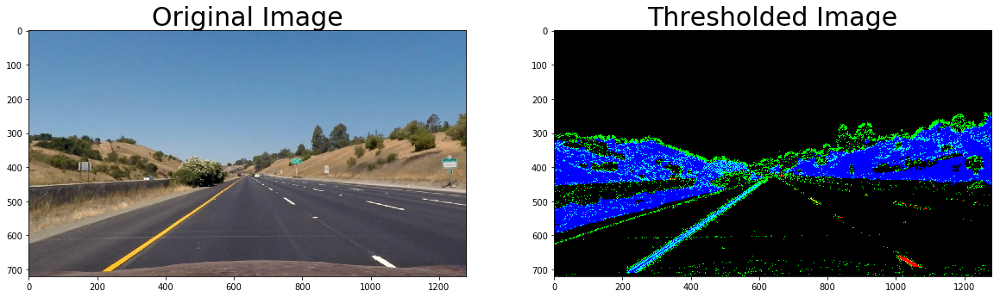

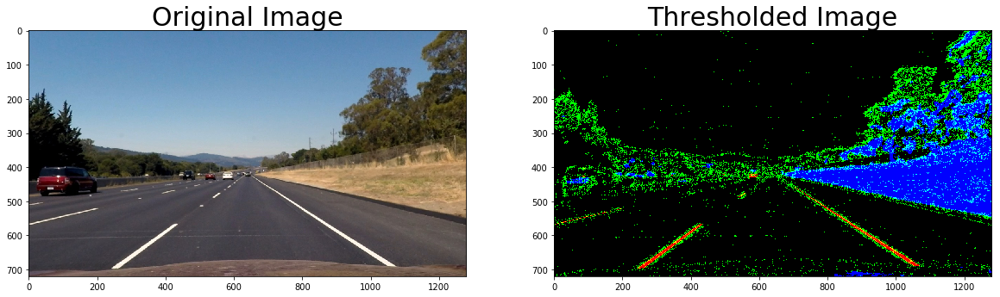

...

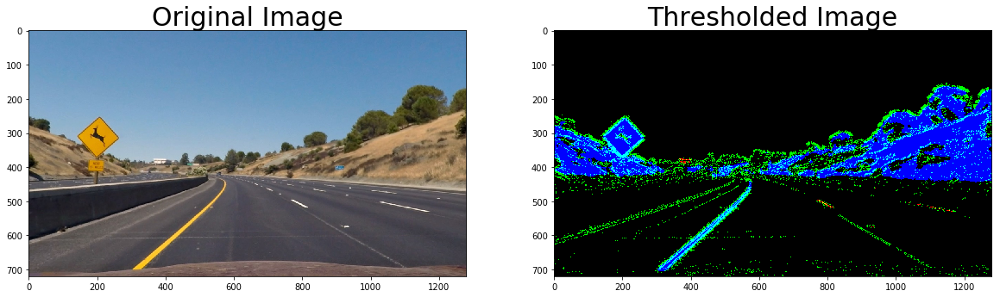

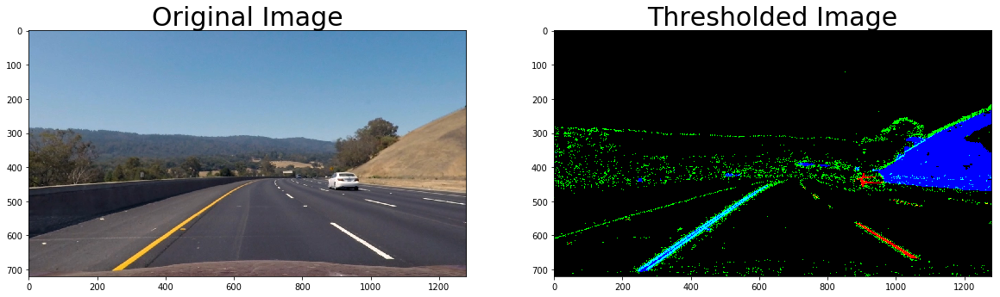

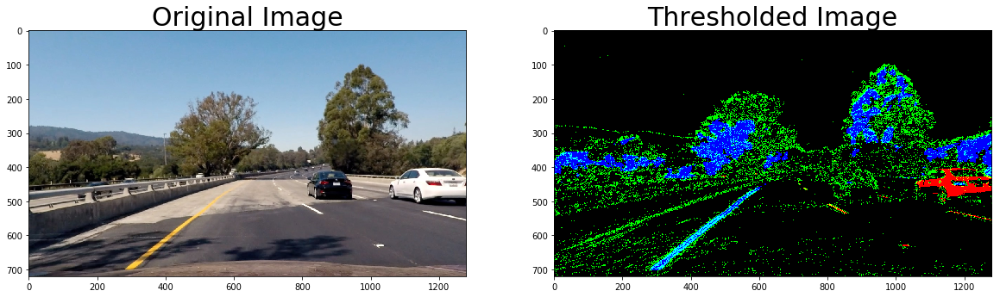

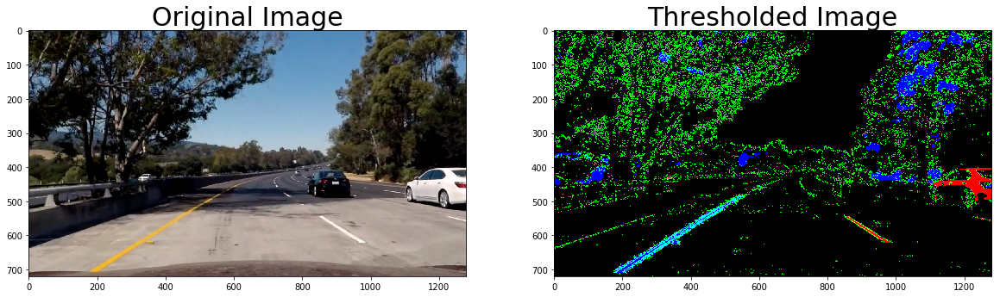

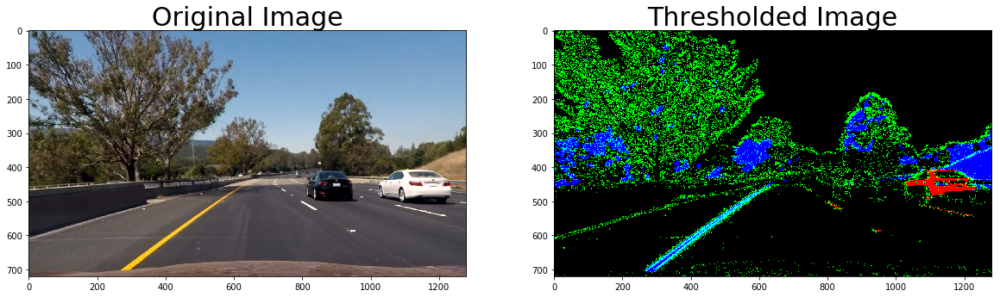

In [6]:
filenames = glob.glob('../test_images/*.jpg')

for index, image in enumerate([ cv2.imread(filename) for filename in filenames ]):
    undistorted = cv2.undistort(image, calibration.camera_matrix, calibration.distortion_coefficients, None)
    edges = get_edge_mask(undistorted, return_all_channels=True)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))

    ax1.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    ax2.imshow(edges)

    ax1.set_title('Original Image', fontsize=30)
    ax2.set_title('Thresholded Image', fontsize=30)
    
    f.savefig('../figures/lane-line-detection-thresholding' + '{:02}'.format(index) + '.jpg')

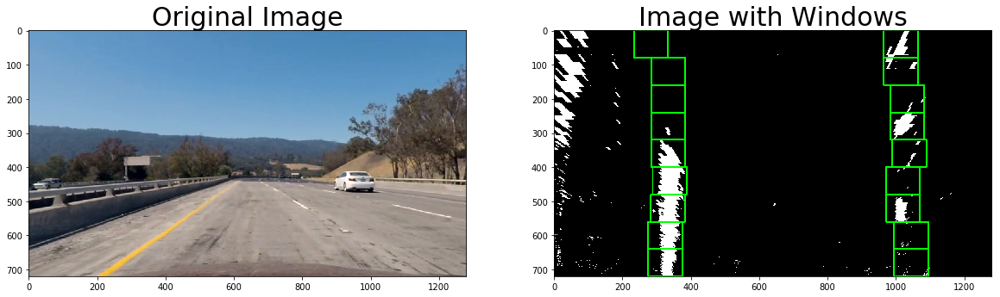

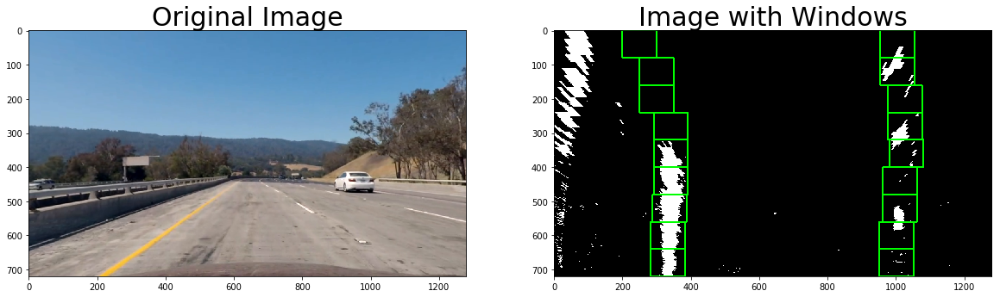

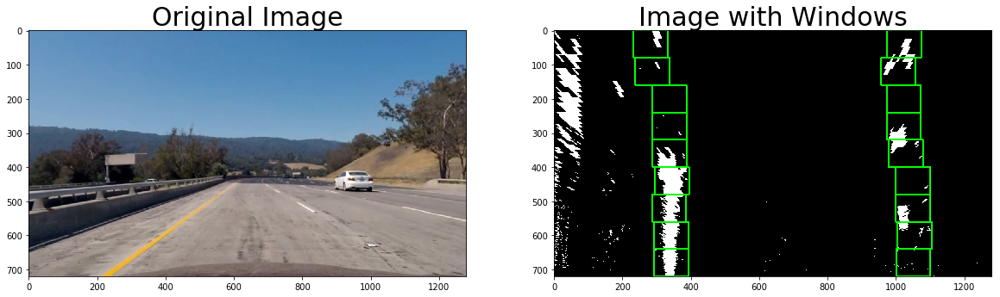

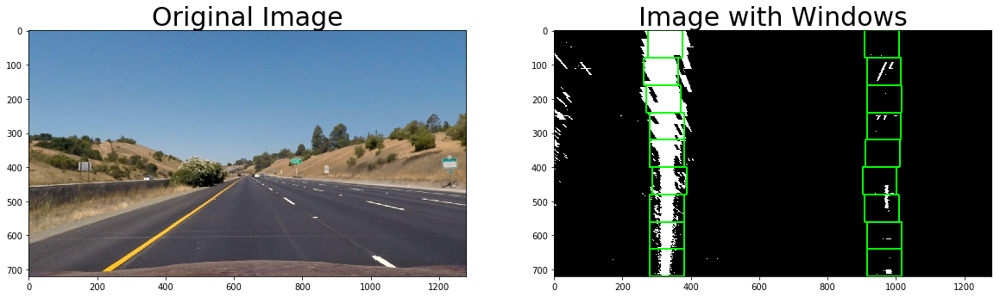

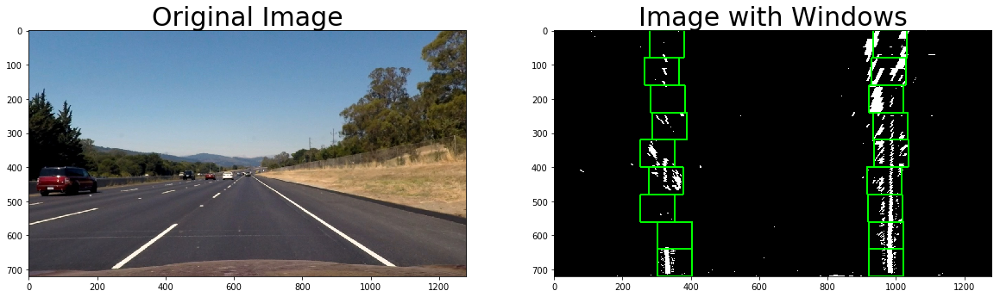

...

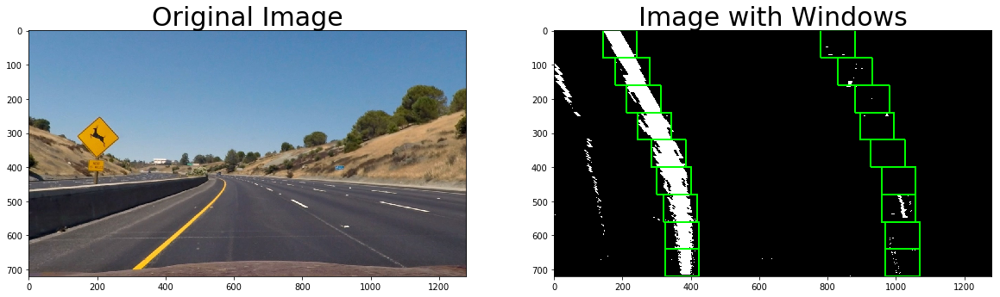

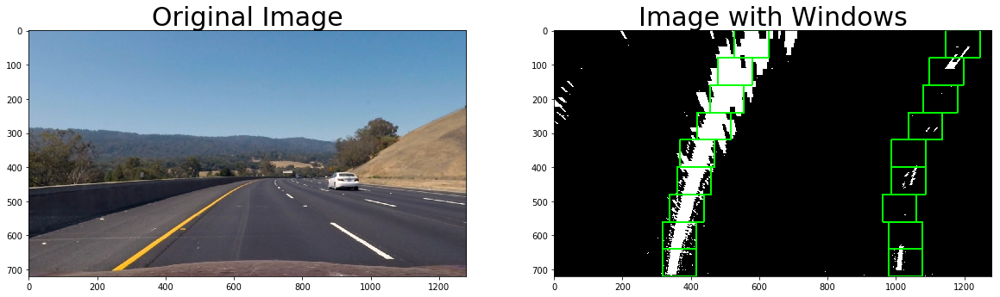

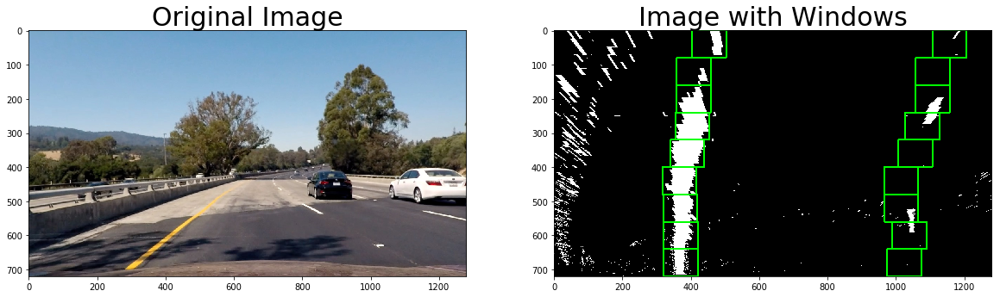

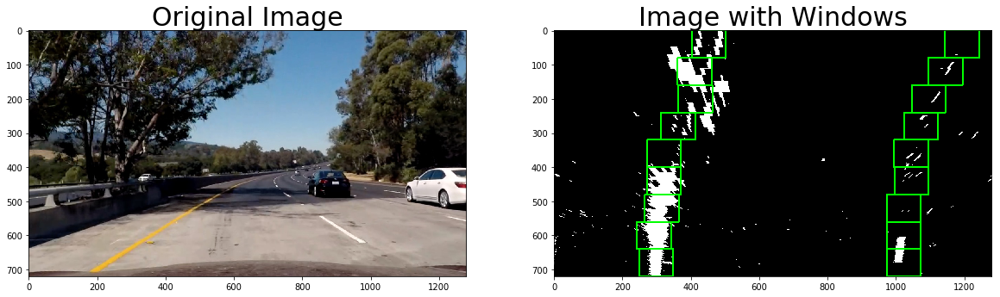

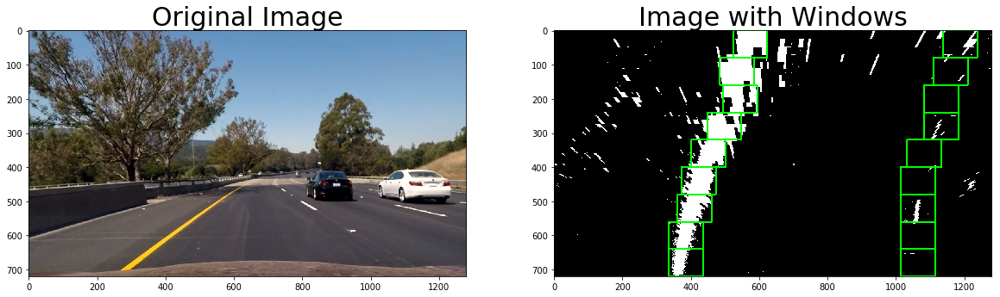

In [10]:
filenames = glob.glob('../test_images/*.jpg')

for index, image in enumerate([ cv2.imread(filename) for filename in filenames ]):
    undistorted = cv2.undistort(image, calibration.camera_matrix, calibration.distortion_coefficients, None)
    filtered = get_edge_mask(undistorted)
    warped = warp_birds_eye(filtered, SOURCE_POINTS, DESTINATION_POINTS)
    
    windows, _, _ = sliding_window(warped)
        
    window_centroids = find_window_centroids(warped)

    warped = draw_windows(warped, window_centroids)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))

    ax1.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    ax2.imshow(warped)

    ax1.set_title('Original Image', fontsize=30)
    ax2.set_title('Image with Windows', fontsize=30)
    
    f.savefig('../figures/windows' + '{:02}'.format(index) + '.jpg')

### Process Single Frame

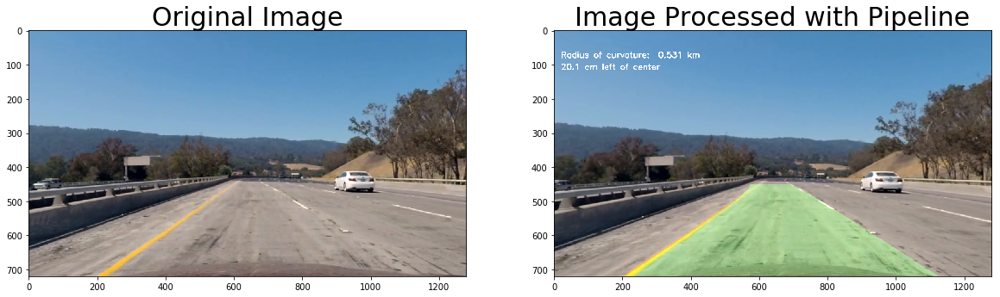

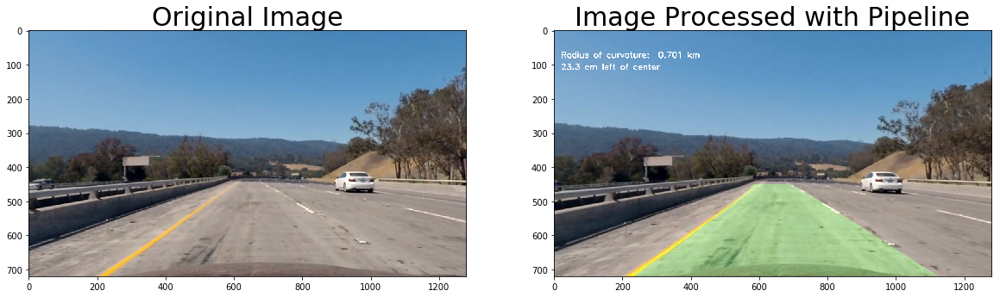

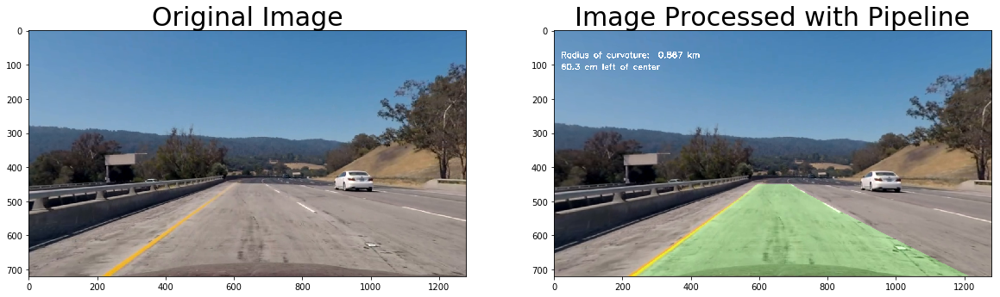

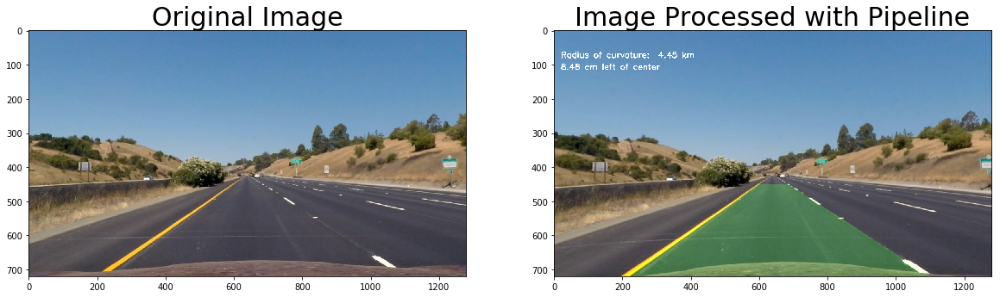

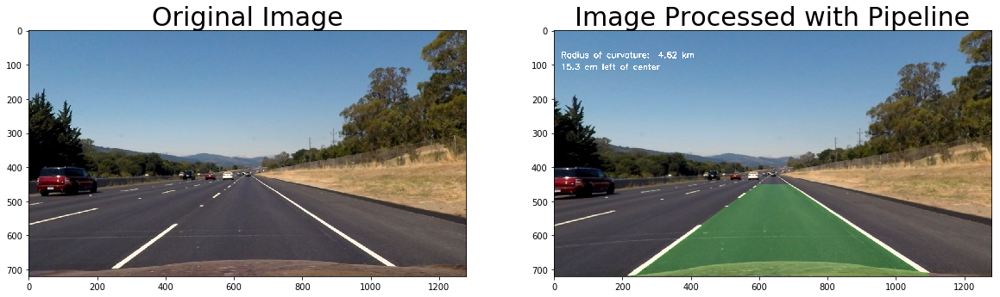

...

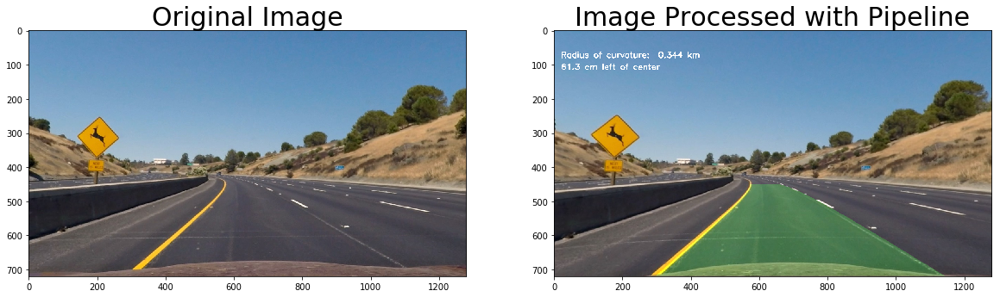

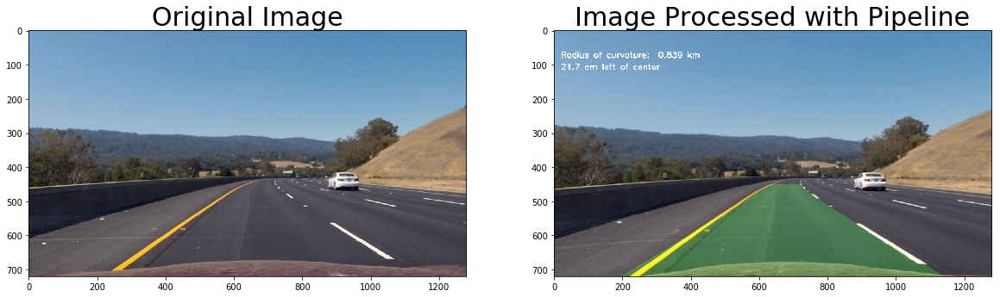

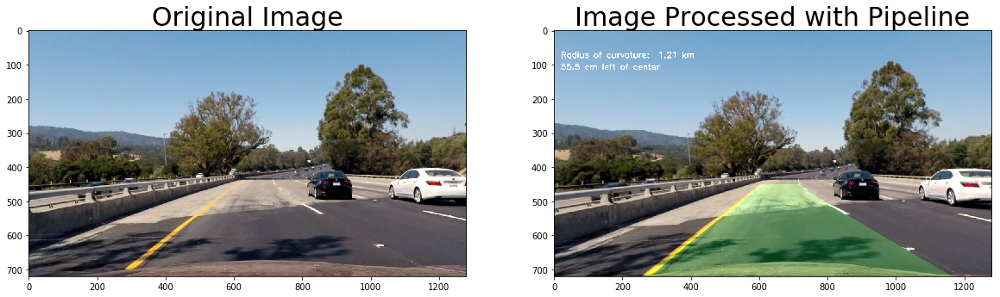

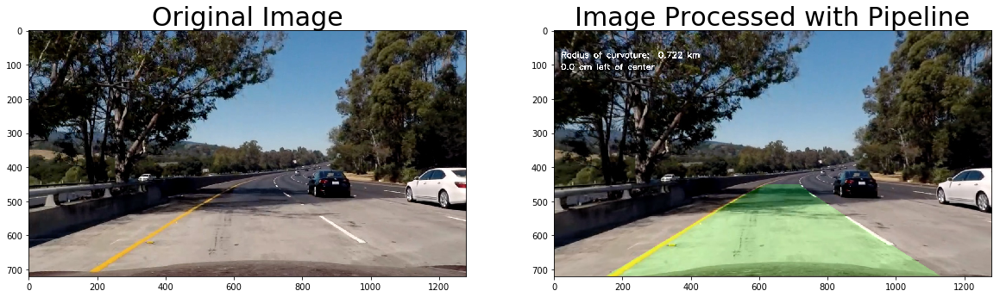

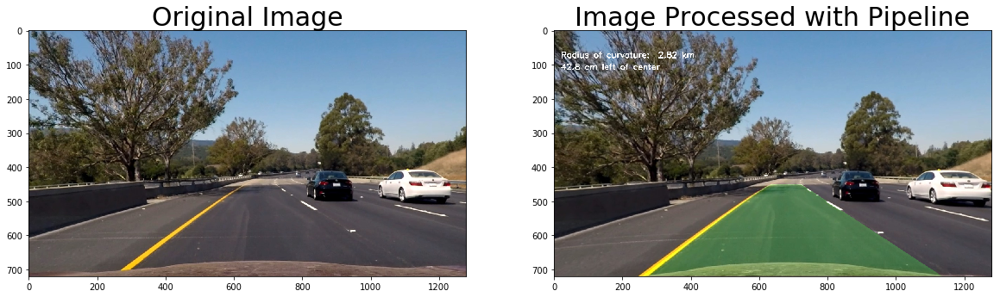

In [11]:
filenames = glob.glob('../test_images/*.jpg')

for index, image in enumerate([ cv2.imread(filename) for filename in filenames ]):
    tracker = LaneLineTracker(
        None, 
        calibration=calibration, 
        source_points=SOURCE_POINTS, 
        destination_points=DESTINATION_POINTS, 
    )

    undistorted = cv2.undistort(image, calibration.camera_matrix, calibration.distortion_coefficients, None)
    output = tracker.process_image(undistorted)

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))

    ax1.imshow(cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB))
    ax2.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB))

    ax1.set_title('Original Image', fontsize=30)
    ax2.set_title('Image Processed with Pipeline', fontsize=30)
    
    f.savefig('../figures/processed-image' + '{:02}'.format(index) + '.jpg')

### Generate Video

In [13]:
video_path = '../project_video.mp4'
output_path = '../project_video_output.mp4'
tracker = LaneLineTracker(
    video_path, 
    calibration=calibration, 
    source_points=SOURCE_POINTS, 
    destination_points=DESTINATION_POINTS, 
    output_path=output_path
)
%time tracker.process_video()

[MoviePy] >>>> Building video ../project_video_output.mp4
[MoviePy] Writing video ../project_video_output.mp4


100%|█████████▉| 1260/1261 [08:40<00:00,  2.50it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: ../project_video_output.mp4 

CPU times: user 8min 1s, sys: 1min 58s, total: 9min 59s
Wall time: 8min 41s
